<a href="https://colab.research.google.com/github/Guillem96/activity-recognition/blob/master/notebooks/FstCN%20tricks%20to%20enhance%20AR.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# FstCN tricks to enhance Video Activity Recognition

[Action Recognition using Factorized Spatio-Temproal convolutional networks](https://arxiv.org/pdf/1510.00562.pdf) paper, proposes a lot of interessting tricks to enhance classification task in video (specially in UCF-101 dataset). The different presented *tricks* are thought to fight against overfitting, solve action alignment issue and capute long range motion.

In this notebook, we go through two different tricks:

- The video clips sampling
- The SCI score fusions at inference time

## Preparing environment

In this section we download the `youtube-dl` CLI tool to download videos from youtube. We also install `activity-recognition` python package so we can use the already implemented `FstCN` tricks.

In [1]:
!git clone "https://github.com/Guillem96/activity-recognition"

Type Guillem96 GitHub password: ··········
Cloning into 'activity-recognition'...
remote: Enumerating objects: 550, done.
remote: Counting objects: 100% (550/550), done.
remote: Compressing objects: 100% (412/412), done.
remote: Total 623 (delta 294), reused 357 (delta 132), pack-reused 73
Receiving objects: 100% (623/623), 86.88 MiB | 29.46 MiB/s, done.
Resolving deltas: 100% (313/313), done.


In [2]:
!pip install av
!wget https://yt-dl.org/downloads/latest/youtube-dl -O /usr/local/bin/youtube-dl
!chmod a+rx /usr/local/bin/youtube-dl
!apt install -y imagemagick
!youtube-dl -f160 http://youtube.com/watch?v=UAO2urG23S4&t
!youtube-dl -f160 http://youtube.com/watch?v=-15UpGVyV4w

     |████████████████████████████████| 36.9MB 93kB/s 
--2020-07-18 13:41:25--  https://yt-dl.org/downloads/latest/youtube-dl
Resolving yt-dl.org (yt-dl.org)... 95.143.172.170, 2001:1a50:11:0:5f:8f:acaa:177
Connecting to yt-dl.org (yt-dl.org)|95.143.172.170|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://yt-dl.org/downloads/2020.06.16.1/youtube-dl [following]
--2020-07-18 13:41:26--  https://yt-dl.org/downloads/2020.06.16.1/youtube-dl
Connecting to yt-dl.org (yt-dl.org)|95.143.172.170|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://github.com/ytdl-org/youtube-dl/releases/download/2020.06.16.1/youtube-dl [following]
--2020-07-18 13:41:27--  https://github.com/ytdl-org/youtube-dl/releases/download/2020.06.16.1/youtube-dl
Resolving github.com (github.com)... 140.82.114.3
Connecting to github.com (github.com)|140.82.114.3|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://githu

In [3]:
%load_ext autoreload
%autoreload 2

import sys
sys.path.append('/content/activity-recognition')

import ar
import ar.transforms as VT

import torch
import torchvision
import torchvision.transforms as T

from IPython.display import HTML, display

import matplotlib.pyplot as plt
from matplotlib import animation, rc

In [4]:
#@markdown Display Video Function
def display_video(video, fig=None, title=''):
    from matplotlib import animation
    from IPython.display import HTML, display

    if fig is None:
        fig = plt.figure()
    
    plt.axis('off')
    im = plt.imshow(video[0,:,:,:])

    plt.close() # this is required to not display the generated image

    def init():
        im.set_data(video[0,:,:,:])

    def animate(i):
        im.set_data(video[i,:,:,:])
        return im

    anim = animation.FuncAnimation(
        fig, animate, init_func=init, frames=video.shape[0], interval=50)
    display(HTML(f"<h1>{title}</h1>" + anim.to_html5_video()))

def display_multiple_clips(clips, figsize=(15, 5)):
    
    def animate(i):
        for j, ax in enumerate(axes):
            ax.set_data(clips[j][i])

    def init_fn():
        for j, ax in enumerate(axes):
            ax.set_data(clips[j][0])

    fig = plt.figure(figsize=figsize)
    axes = []
    for i, clip in enumerate(clips, start=1):
        ax = plt.subplot(2, len(clips) // 2, i)
        plt.axis('off')
        im = plt.imshow(clip.numpy()[0])
        axes.append(im)

    anim = animation.FuncAnimation(
            fig, animate, init_func=init_fn, frames=clips[0].size(0), 
            interval=50)
    plt.close()

    rc('animation', html='jshtml')
    display(anim)
    return anim

def display_video_f(fname):
    from base64 import b64encode
    mp4 = open(fname,'rb').read()
    data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
    display(HTML("""
    <video width=400 controls>
        <source src="%s" type="video/mp4">
    </video>
    """ % data_url))

In [5]:
display_video_f('Hollow Knight - Release Trailer-UAO2urG23S4.mp4')

## Sampling strategy

In this work, authors instead of deliberately detecting and aligning action instances from video sequences and extracting the corresponding clip, they sample $M$ clips from a video.

Each video clip in FstCN, scheme is produced by temporally sampling with a stride $s_t$ and spatially cropping (crop of size $l_x \times l_y$) from the same location of the given video.

Threrefore, respresenting a video $V$ as $V \in \mathbb{R}^{m_x \times m_y \times m_t}$ we say that a sampled video clip $V_{clip}$ belongs to $\mathbb{R}^{l_x \times l_y \times l_t}$, where all $l_i < m_i$

In [6]:
video, audio, info = torchvision.io.read_video(
    'Hollow Knight - Release Trailer-UAO2urG23S4.mp4', pts_unit='sec')
video.size()
video_it = ar.io.VideoFramesIterator(
    'Hollow Knight - Release Trailer-UAO2urG23S4.mp4',
    transforms=ar.transforms.valid_tfms())

torch.Size([3698, 144, 256, 3])

In [7]:
M = 18 #@param {"type": "slider", "min": 5, "max": 30}
CLIP_LEN = 16 #@param {"type": "slider", "min": 8, "max": 32}
STRIDE = 2 #@param {"type": "slider", "min": 1, "max": 8}

We first uniformly sample the $M$ clips of `CLIP_LEN` frames each and frames separated with `STRIDE` frames.


In [8]:
video_clips = ar.video.uniform_sampling(video_it, 
                                        clips_len=CLIP_LEN, 
                                        frames_stride=STRIDE, 
                                        n_clips=M)

# Make sure that we've just sampled the M clips
assert len(video_clips) == M

video_clips[0].size()

torch.Size([16, 144, 256, 3])

Now that we have the sampled clips, we randomly crop a region of size $l_x \times l_y$.

In [9]:
crop_size = (204, 204)
crop_fn = T.Compose([VT.VideoToTensor(), 
                     VT.VideoResize((256, 256)),
                     VT.VideoRandomCrop(crop_size)])
cropped_video_clips = [crop_fn(o).permute(1, 2, 3, 0) for o in video_clips]
display_multiple_clips(cropped_video_clips, figsize=(15, 5)).save(
    'video_clips.gif', writer='imagemagick')

However, sampling $M V_{clip}$ it only conveys long-range motion dynamics when the temporal stride $s_t$ is relatively large. To add in the information of short range motion dynamics, for each frame of the video, we compute $V^{diff}$.

Where: $V^{diff}(:,:,i_t) = \left| V(:,:,i_t) - V(:,:,i_t + d_t) \right |$

In [10]:
DT = 5 #@param {"type": "slider", "min": 2, "max": 10}

In [11]:
Vdiff = video[:-DT] - video[DT:]
Vdiff.abs_();

We repeat the exact same process to sample again $M$ different $ V^{diff}_{clip}$ of size $l_x \times l_y$ 

In [12]:
video_diff_clips = ar.video.uniform_sampling(video=Vdiff, 
                                             clips_len=CLIP_LEN, 
                                             frames_stride=STRIDE, 
                                             n_clips=M)

In [13]:
cropped_video_diff_clips = [crop_fn(o).permute(1, 2, 3, 0) 
                            for o in video_diff_clips]
display_multiple_clips(cropped_video_diff_clips, figsize=(15, 5)).save(
    'video_clips_diff.gif', writer='imagemagick')

### Conclusions

Using this strategy sampling:

- We fight agains overfitting (sample random spatial and temporal crops)
- We capture long and short range motion
- Take into account that the parameters $s_t$ and $d_t$ can be tuned indirectly by resampling the video at a slower or faster frame rate


## SCI Score fusion

At inference time, to accurately predict the action present in a video we use different clips sampling strategies:

- Uniformly sample $M$ clips from the whole video and average the predictions
- Analyze the whole clips present in a video using a sliding window with a specific stride and afterwards, we average all clips' scores.
- Randomly sample $M$ clips, flip them and analyze the both versions (the fliped and non-fliped) and finally average the model scores.

....

All the mentioned approches, use late fusion averaging the predictions- As you may have noticed, this approach assumes that all clips cotribute in the same manner at the final prediction which usually is not true.

In this section we present a new fusion method approach called SCI along a new inference clips sampling strategy.


### Clips sampling

1. Sample $M$ different pairs of $\{V_{clip}, V_{clip}^{diff}\}$.
2. For each pair, we generate $C$ crops, which can be randomly generated, or folowing a shceme. For instance you can crop the clips in 9 equally sized regions.
3. Flip each crop so we end up with $2 \cdot C$ crops

In [14]:
M = 10 #@param {"type": "slider", "min": 5, "max": 30}
CLIP_LEN = 19 #@param {"type": "slider", "min": 8, "max": 32}
STRIDE = 3 #@param {"type": "slider", "min": 1, "max": 8}
C = 5 #@param {"type": "slider", "min": 2, "max": 10}

In [15]:
video, *_ = torchvision.io.read_video('CC feeding fish in Hawaii--15UpGVyV4w.mp4')
video.size()

/usr/local/lib/python3.6/dist-packages/torchvision/io/video.py:105: UserWarning: The pts_unit 'pts' gives wrong results and will be removed in a follow-up version. Please use pts_unit 'sec'.
  + "follow-up version. Please use pts_unit 'sec'."


torch.Size([231, 144, 192, 3])

In [16]:
display_video_f('/content/CC feeding fish in Hawaii--15UpGVyV4w.mp4')

In [17]:
fstCN_clips = ar.video.FstCN_sampling(video_it, 
                                      n_clips=M,
                                      clips_len=CLIP_LEN, 
                                      n_crops=C,
                                      frames_stride=STRIDE,
                                      crops_size=(112, 112))

fstCN_clips_t = torch.stack([torch.stack(o) for o in fstCN_clips])

n, c, f, _, _, _ = fstCN_clips_t.size()
print('Clips tensor shape:', fstCN_clips_t.size())
print(f'[{n} clips, {c} crops of each clip, clips of {f} frames, H, W, C]')

Clips tensor shape: torch.Size([10, 10, 19, 112, 112, 3])
[10 clips, 10 crops of each clip, clips of 19 frames, H, W, C]


In [18]:
display_multiple_clips(fstCN_clips[1]).save(
    'uniform_crops_flip.gif', writer='imagemagick')

### SCI Score Fusion

For a test video, denote the score output of class probability for the $k_{th}$ cropped video of the $i_{th}$ sampled video clip pair as
$p_{k,i} \in \mathbb{R}^N$ where N is the number of possible outcomes (classes). $N=400$ in kinetics-400, for instance.

The final score $\hat{p}$ can simply be obtained using a mean $\frac{1}{CM} \sum_{i}^{M} \sum_{k}^C p_{k_i}$ which usually is not the best thing to do since clips do not contribute in the same manner when classifing the action contained in it.

We can compute a weighted average of the outputed probabilities. FstCN authors give more weight to reliable $p$. We understand that a $p$ is reliable when it has low entropy (meaning the probabilities that the test
video sequence is of the corresponding action categories are
high). Thus, the high entropy probabilities distributions get a lower weighing.

In [19]:
# Suposo N = 10
N = 10
high_entropy_p = torch.rand(N).softmax(0)
low_entropy_p = torch.rand(N)
low_entropy_p[N // 2] = 3
low_entropy_p = low_entropy_p.softmax(0)

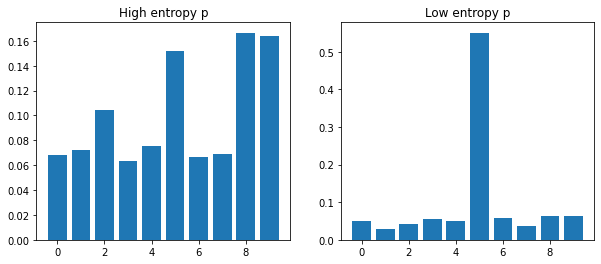

In [20]:
plt.figure(figsize=(10, 4))
plt.subplot(121)
plt.title('High entropy p')
plt.bar(range(N), high_entropy_p)

plt.subplot(122)
plt.title('Low entropy p')
plt.bar(range(N), low_entropy_p);

The weight for each distribution is computed as

$SCI(p) = \frac{N * max_{j=1...N}(p_j) - 1}{N - 1}$

Then, if low entropy distributions should have a larger weight, the right ditribution (above figure), should have a larger $SCI(p)$

In [21]:
high_e_w = ar.video.fusion.SCI_weights(high_entropy_p)
low_e_w =  ar.video.fusion.SCI_weights(low_entropy_p)

print(f'Low entropy weight {low_e_w:.4f} is larger than a '
      f'high entropy weight {high_e_w:.4f}')

Low entropy weight 0.5004 is larger than a high entropy weight 0.0739


Then, using the computed weights we perform the weighted average across all crops $C$ of a clip $i$:

$p_i = \frac{\sum_{k}^{C} SCI(p_{k,i})\cdot p_{k,i}}
            {\sum_{k}^{C} SCI(p_{k,i})}$

The above equation results in the probability distribution from $i$th clip.

Finally, for each class we choose the max probability among all clips

$\hat{p} = max_{row}(p_1, p_2, ..., p_i)$


In [22]:
tfms = T.Compose([VT.VideoToTensor(), 
                  VT.VideoResize((112, 112)),
                  VT.VideoNormalize(mean=[0.43216, 0.394666, 0.37645],
                                    std=[0.22803, 0.22145, 0.216989])
                ])

To demonstrate that this fusion score works, we will apply the stated sampling strategy and try to guess the class of the previously seen *feeding fish* video.

To obtain the probability distribution of each crop, we are going to use a `torchvision` pretrained model.

In [23]:
model = torchvision.models.video.r3d_18(pretrained=True)
model.eval()
classes = open('activity-recognition/data/kinetics400.names').readlines()
classes = list(map(str.strip, classes))

Downloading: "https://download.pytorch.org/models/r3d_18-b3b3357e.pth" to /root/.cache/torch/checkpoints/r3d_18-b3b3357e.pth


We normalize the videos according to the training mean and std

In [24]:
norm_clips = []
for clip in fstCN_clips:
   norm_clips.append(torch.stack([tfms(o) for o in clip]))
norm_clips = torch.stack(norm_clips)

Extract all probabilities for all the clips and crops

In [25]:
N = 400 # Model pretrained on Kinetics-400

pik = []
for i, clip_crops in enumerate(norm_clips, start=1):
    print(f'Clips [{i}/{len(norm_clips)}]')
    with torch.no_grad():
        pik.append(model(clip_crops))

pik = torch.stack(pik)
print('Probabilities pik:', pik.size())

Clips [1/10]
Clips [2/10]
Clips [3/10]
Clips [4/10]
Clips [5/10]
Clips [6/10]
Clips [7/10]
Clips [8/10]
Clips [9/10]
Clips [10/10]
Probabilities pik: torch.Size([10, 10, 400])


Finally, we fuse the crops using the described method

In [26]:
p_hat = ar.video.fusion.SCI_fusion(pik, from_logits=True)
top_5_classes = p_hat.topk(10, dim=0)
top_5_classes
for k, (v, i) in enumerate(zip(*top_5_classes), start=1):
    print(f'Top {k} class {classes[i]} with score {v:.3f}')

Top 1 class feeding fish with score 0.853
Top 2 class shaving legs with score 0.443
Top 3 class waxing legs with score 0.116
Top 4 class cleaning shoes with score 0.106
Top 5 class tobogganing with score 0.062
Top 6 class cleaning gutters with score 0.048
Top 7 class water skiing with score 0.039
Top 8 class petting cat with score 0.038
Top 9 class watering plants with score 0.038
Top 10 class washing hair with score 0.028


### Conclusions

- SCI Fusion provides a more robust aggregation method
- Sampling C crops for each sampled clip can help to generate a *high confidence output* 